# Differentiable 2D Rendering in JAX

In [1]:
import jax
import jax.numpy as np
import os

os.environ["CHALK_JAX"] = "1"
from chalk import *
from colour import Color
from IPython.display import HTML
import optax
import chalk.transform
import glob
import matplotlib.pyplot as plt
from functools import partial

# chalk.transform.set_jax_mode(False)
eps = 1e-3

HTML("""
<script src="https://unpkg.com/freezeframe/dist/freezeframe.min.js"></script>
""")

An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.


In [2]:
import imageio.v3 as imageio
import base64

# import PIL
ff_id = 0


def animate_out(images, steps=36, rate=20, **kwargs):
    global ff_id
    # with imageio.get_writer("/tmp/out.gif", loop=0, fps=rate, **kwargs) as writer:
    writer = []
    for im in images:
        image = imageio.imread(im)
        # image = PIL.Image.open(im)
        writer.append(image)
    # writer[0].save('/tmp/out.gif', save_all=True, append_images=writer,
    #               loop=0, duration=200, transparency=0, disposal=0)
    imageio.imwrite("/tmp/out.gif", writer, loop=0, fps=rate, **kwargs)
    # imageio.mimsave(
    base = base64.b64encode(open("/tmp/out.gif", "br").read()).decode("ascii")
    ff_id += 1
    return HTML(f"""
  <img src="data:image/gif;base64,{base}" id='ff{ff_id}'>
<script>
new Freezeframe({{
  selector: '#ff{ff_id}'  
}});
</script>

<style>
  .ff-container.ff-responsive: width: 60%;
</style>

  """)


grid = rectangle(4, 4).fill_color("white").line_width(0) + (
    make_path([(-2, 0), (2, 0)]) + make_path([(0, -2), (0, 2)])
).line_color("grey").line_width(1)
hgrid = rectangle(10, 10).fill_color("white").line_width(0).align_tl()
bgrid = rectangle(100, 100).fill_color("white").line_width(0).align_tl()


def animate(fn1, steps=36, rate=20, grid=grid, lw=True, **kwargs):
    os.system("rm /tmp/render*.png /tmp/out.gif 2> /dev/null")
    images = []

    def fn(t):
        im = fn1(t / steps)
        if isinstance(im, tuple):
            im, extra = im
        else:
            extra = empty()

        return hcat(
            [grid + (im.with_envelope(empty()).line_width(2 if lw else None)), extra],
            0.4,
        ).layout(500)

    if chalk.transform.JAX_MODE:
        fn = jax.jit(fn)

    for t in range(1, steps):
        p = f"/tmp/render.{t:03d}.png"
        out, h, w = fn(t)
        # (grid + out.line_width(2).with_envelope(empty()))
        chalk.backend.cairo.prims_to_file(out, p, h, w)
        # (grid + fn(t).line_width(2).with_envelope(empty())).render_svg(f"/tmp/render.{t:03d}.svg", 400)
        images.append(p)
    return animate_out(images)


@jax.vmap
def inner(j, i, a):
    op = np.minimum(1.0, np.abs(a))
    return (
        rectangle(0.75, 0.75, 0.1)
        .center_xy()
        .translate(i, j)
        .fill_color(
            op * np.where(a > 0, to_color("blue"), to_color("red")) + (1 - op) * 1
        )
        .line_width(0)
    )


@jax.jit
def show_affine(aff):
    out = inner(np.arange(9) // 3, np.arange(9) % 3, aff.reshape(-1))
    return out.center_xy().scale(
        0.5
    )  # (vrule(3).line_width(1) |  | vrule(3).line_width(1)).flatten()


@jax.jit
def show_color(color):
    out = inner(np.arange(3), np.zeros(3), color.reshape(-1))
    return out.center_xy().scale(
        0.5
    )  # (vrule(3).line_width(1) |  | vrule(3).line_width(1)).flatten()


import copy


def show_arc(a):
    a = copy.deepcopy(a)
    angles = a.segments.angles
    angles = angles.at[0, 1].set(360)
    a.segments.angles = angles
    return a

## Transforms

We'll start with a gentle introduction to 2D vector graphics. 

In [3]:
line = seg(V2(1, 1)).stroke()


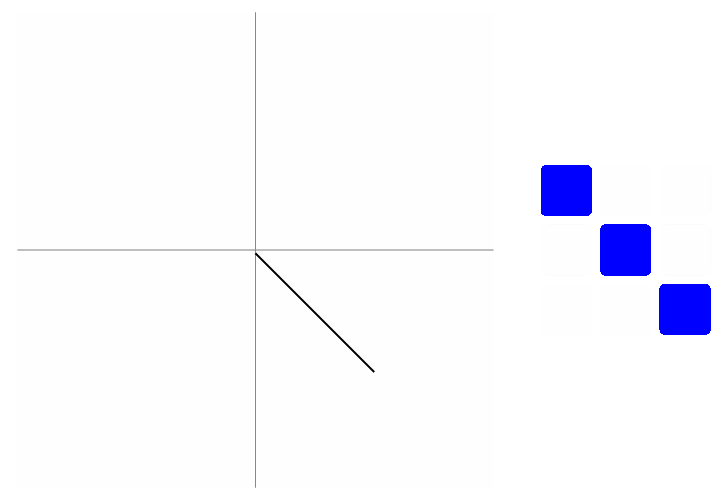

In [4]:
def translate(t):
    affine = tx.translation(V2(0, t))
    return line.apply_transform(affine), show_affine(affine)


animate(translate)


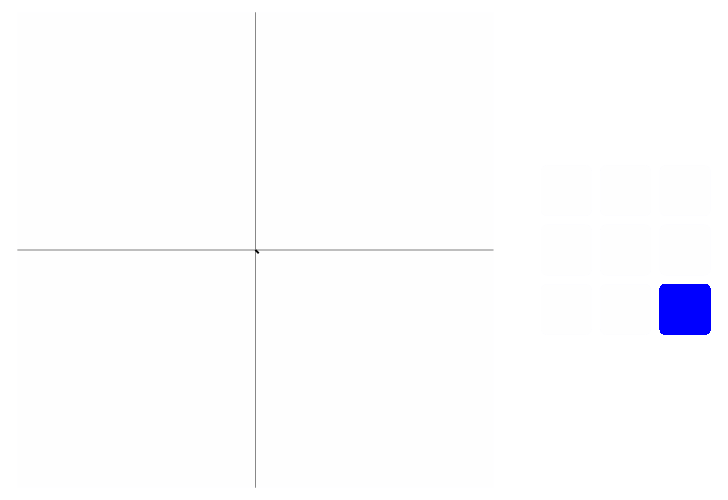

In [5]:
def scale(t):
    affine = tx.scale(t)
    return line.apply_transform(affine), show_affine(affine)


animate(scale)


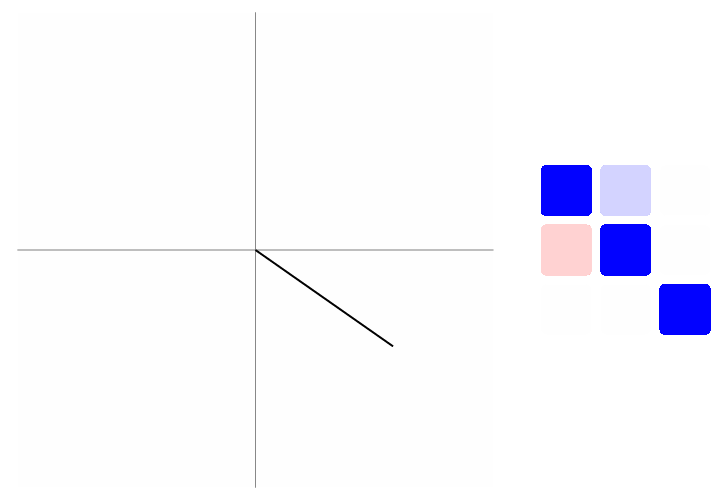

In [6]:
def rotate(t):
    affine = tx.rotation(t * 2 * np.pi)
    return line.apply_transform(affine), show_affine(affine)


animate(rotate)


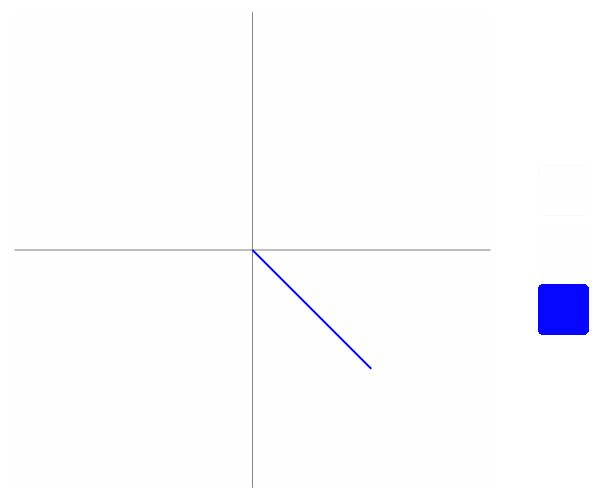

In [7]:
def color_line(t):
    red = to_color("red")
    blue = to_color("blue")
    color = t * red + (1 - t) * blue
    return line.line_color(color), show_color(color)


animate(color_line)


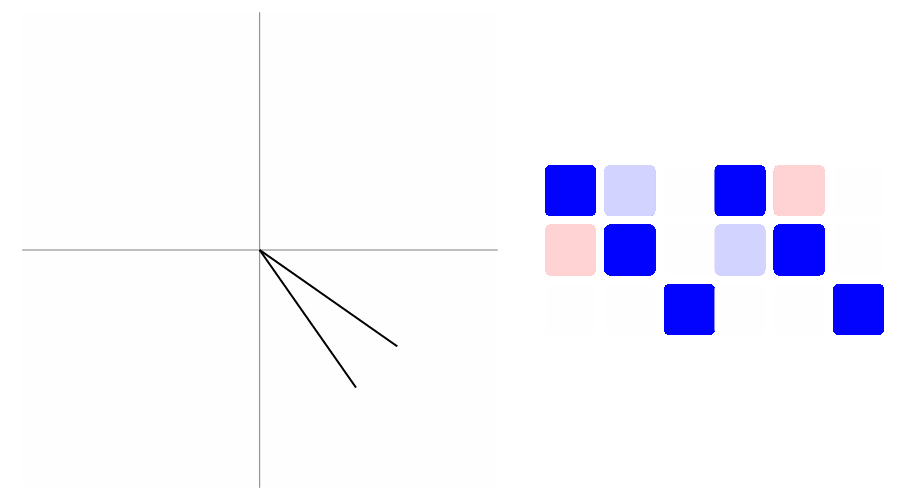

In [8]:
def cat(t):
    affine = tx.rotation(t * 2 * np.pi)
    affine2 = tx.inv(affine)
    return line.apply_transform(affine) + line.apply_transform(affine2), show_affine(
        affine
    ) | show_affine(affine2)


animate(cat)

## Arcs and Shapes


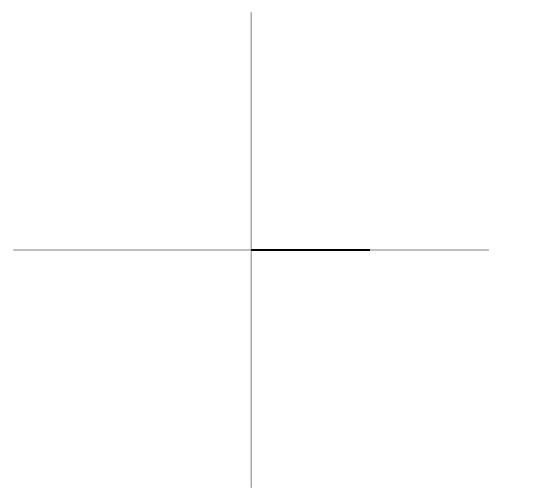

In [9]:
def arc(t):
    v = V2(1, 0)
    a_s = arc_seg(v, t)
    return a_s.stroke()


animate(arc)


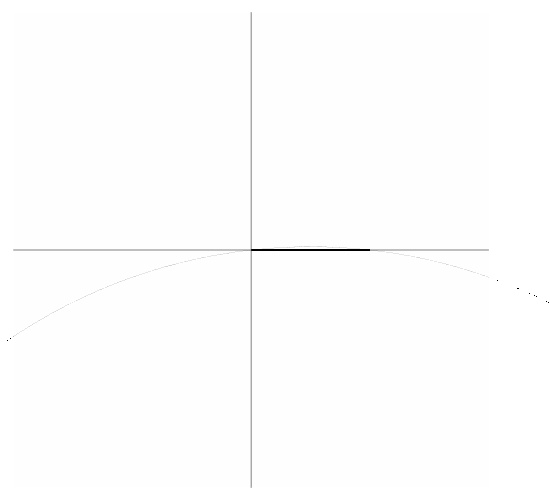

In [10]:
def arc(t):
    v = V2(1, 0)
    a_s = arc_seg(v, t)
    return a_s.stroke().line_width(2) + show_arc(a_s).stroke().line_width(0.1)


animate(arc, lw=False)


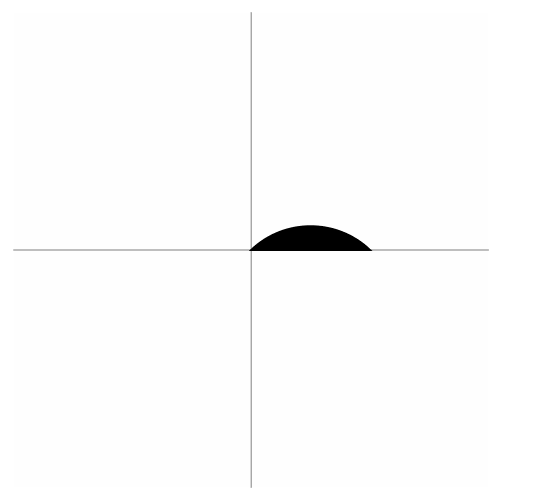

In [11]:
def closed(t):
    v = V2(1, 0)
    return (arc_seg(v, t) + arc_seg(-v, -0.2)).close().stroke()


animate(closed)


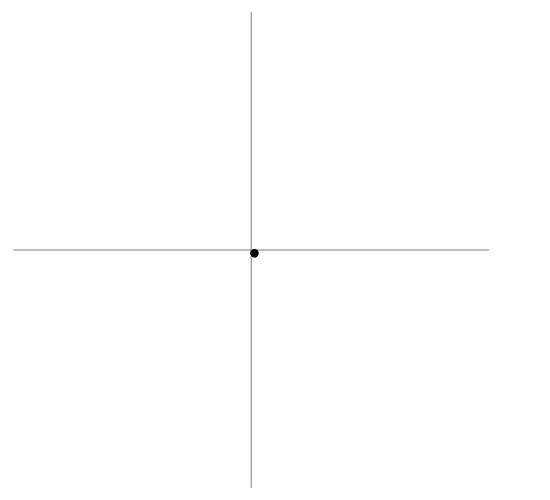

In [12]:
def circle_at(p, s):
    circle = (arc_seg(V2(0, 2), 1) + arc_seg(V2(0, -2), 1)).close().stroke()
    affine = tx.translation(p) @ tx.scale(s) @ tx.translation(V2(0, -1))
    return circle.apply_transform(affine)


def draw_circle(t):
    return circle_at(t, t)


animate(draw_circle)

## Tracing


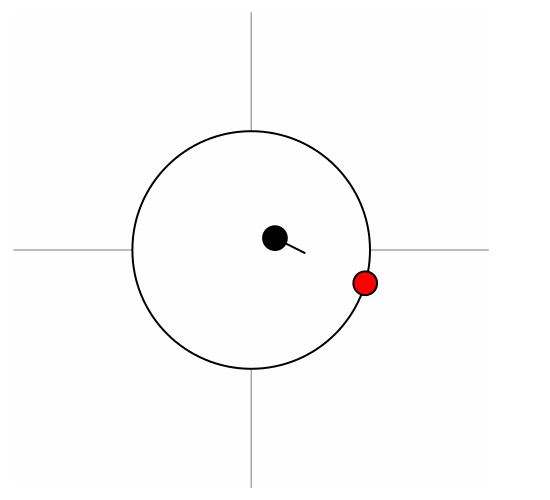

In [36]:
def ray(t, shape, pt, v):
    ray = seg(v).stroke().scale(t + 0.1).translate_by(pt) + circle_at(pt, 0.1)
    trace = shape.get_trace()
    s, m = trace(pt, v)
    return shape + ray + circle_at(np.max(s) * v + pt, 0.1).fill_color("red")


shape = circle_at(P2(0, 0), 1).fill_color("white")

animate(partial(ray, shape=shape, pt=P2(0.2, -0.1), v=V2(2, 1)))


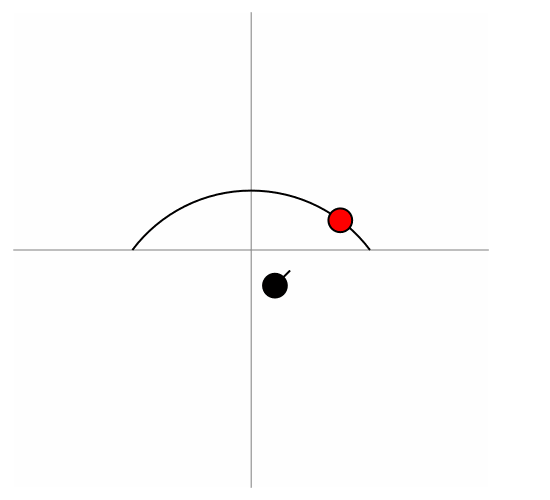

In [42]:
shape = arc_seg(V2(2, 0), 0.5).stroke().translate(-1, 0)
animate(partial(ray, shape=shape, pt=P2(0.2, 0.3), v=V2(1, -1)))

In [15]:
def crescent():
    part1 = arc_seg(unit_x, 0.5)
    part2 = arc_seg(-unit_x, -0.2)
    return part1, part2, (part1 + part2).close().stroke()


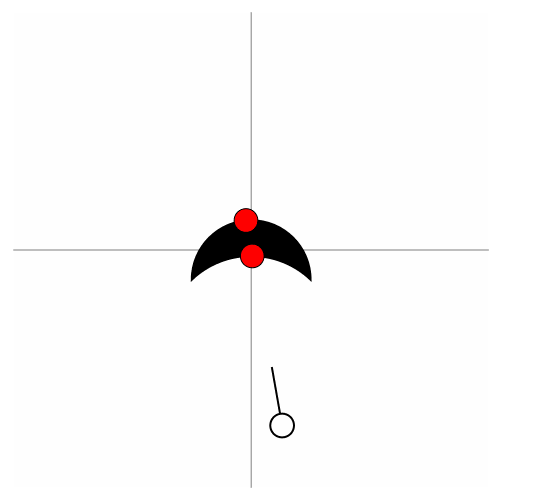

In [16]:
def trace(d, t, px=0, py=0):
    # Place the ray
    d = d.center_xy()
    affine = tx.rotation(t * 2 * np.pi)
    pt, v = P2(0, 1.5), V2(0, -1.5)
    pt, v = affine @ pt + V2(px, py), affine @ v

    # Trace gives distance to arcs
    trace = d.get_trace()
    p, m = trace(pt, v)

    # Draw
    line = seg(V2(0, -1 / 2)).stroke()
    out = (
        d
        + line.apply_transform(tx.translation(pt) @ affine)
        + circle_at(pt, 0.1).fill_color("white")
    )
    out = out.line_width(2)
    for i in range(p.shape[1]):
        out = out + circle_at(p[:, i] * v + pt, 0.1).fill_color("red").fill_opacity(
            m[:, i]
        ).line_width(m[:, i])
    return out


animate(partial(trace, crescent()[2]), lw=False)

How does this work?


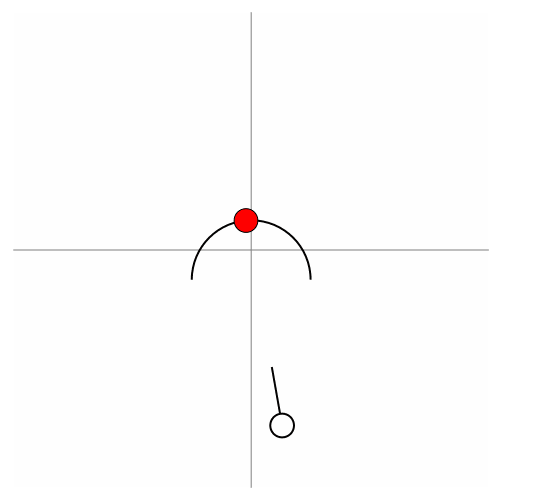

In [17]:
animate(partial(trace, crescent()[0].stroke()), lw=False)


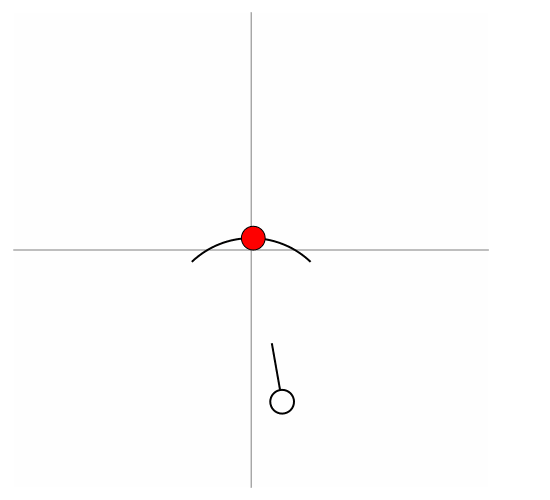

In [18]:
animate(partial(trace, crescent()[1].stroke(), py=-0.2), lw=False)

Overlap at the origin

## Optimization.

In [19]:
def opt(x, fn, steps=100, verbose=False, save_every=1, rate=0.3):
    fn = jax.jit(jax.value_and_grad(fn, has_aux=True))
    solver = optax.adam(learning_rate=rate)
    opt_state = solver.init(x)
    loss = []
    os.system("rm /tmp/test*.png 2> /dev/null")
    for j in range(steps):
        value, grad = fn(x)
        score, out = value
        loss.append(score)
        out, h, w = out
        updates, opt_state = solver.update(grad, opt_state, x)
        x = optax.apply_updates(x, updates)

        if j % save_every == 0:
            chalk.backend.cairo.prims_to_file(out, f"/tmp/test.{j:03d}.png", h, w)
        if verbose:
            print(x)
    plt.plot(loss)
    images = sorted(glob.glob("/tmp/test.*.png"))
    return animate_out(images)

In [20]:
def render_trace(d, pt, v):
    # Trace the image
    trace = d.get_trace()
    p, m = trace(pt, v)

    line = seg(V2(0, -1 / 2)).stroke()
    out = d + seg(v).stroke().translate_by(pt) + circle_at(pt, 0.1).fill_color("white")
    pos = (1 - m[:, :])[..., None, None] * 100 + p[..., None, None] * v + pt
    out = out + Path.from_points([pos[:, 0], pos[:, 1] + eps]).stroke().line_color(
        "white"
    ).line_width(10)
    for i in range(2):
        out = out + circle_at(pos[:, i], 0.1).fill_color("red")
    return out, p


# render_trace(crescent()[2].center_xy(), P2(1, 1), V2(-1, -1))[0]


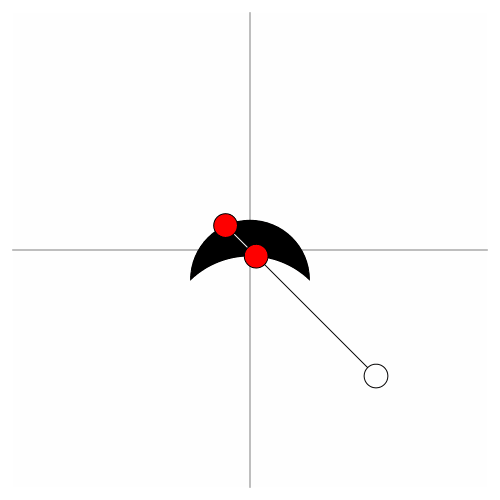

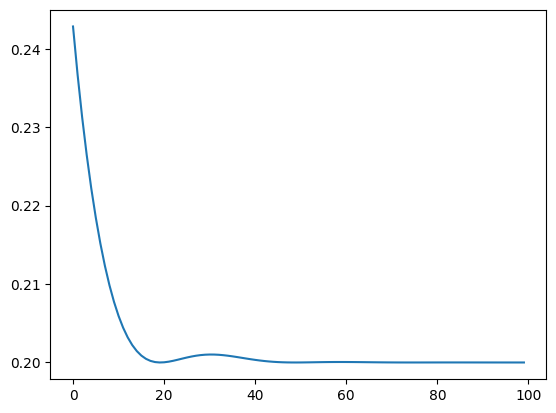

In [21]:
def trace(d, t, px=0, py=0):
    d = d.center_xy()
    # Outer satelite
    affine = tx.rotation(t)
    pt, v = P2(0, 1.5), V2(0, -1.5)
    pt, v = affine @ pt + V2(px, py), affine @ v

    # Trace the image
    out, p = render_trace(d, pt, v)
    score = p[:, 1] - p[:, 0]
    return score.sum(), (grid + out.line_width(1)).layout(500)


opt(np.array(np.pi / 4.0), partial(trace, crescent()[2]), rate=0.05)

## Jax


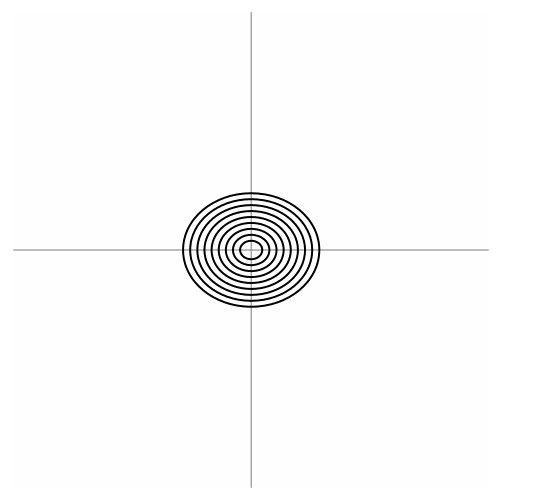

In [22]:
def draw(t):
    @jax.vmap
    def multi(i):
        return circle_at(P2(0, 0), (0.05 * i + t)).scale_x(1.2).fill_opacity(0)

    return multi(np.arange(1, 10))


animate(draw)


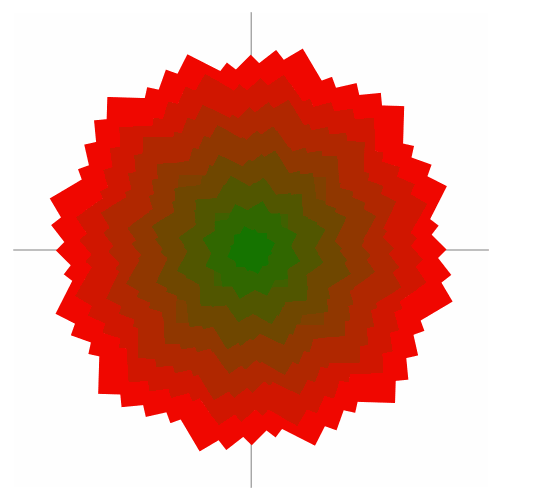

In [23]:
def draw(t):
    red = to_color("red")
    green = to_color("green")

    @jax.vmap
    def multi(i):
        i_s = i / 100
        s = (0.05 * i) / 2
        rot = tx.rotation(i * t + i)
        return (
            rectangle(s, s)
            .fill_color(i_s * red + (1 - i_s) * green)
            .line_width(0)
            .apply_transform(rot)
        )

    return multi(np.arange(100, 1, -1))


animate(draw, lw=False, steps=200, rate=5)


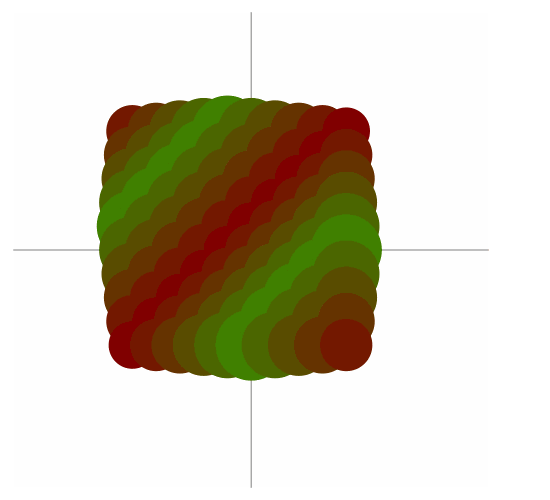

In [24]:
T = 100


def multi(t):
    r = chalk.style.to_color("red")
    g = chalk.style.to_color("green")

    @jax.vmap
    def draw(x, y):
        t2 = (x + y + t) % 1
        t2 = np.maximum(t2, 1 - t2)
        return (
            circle_at(P2(x, y), t2 / 10 - 0.2)
            .fill_color(t2 / 2 * r + 2 * (1 - t2) * g)
            .translate(-0.5, -0.5)
            .scale(2)
            .line_width(0)
        )

    return draw((np.arange(T) // 10) / 10, (np.arange(T) % 10) / 10)


animate(jax.jit(multi), steps=10, lw=False)

Putting it all together


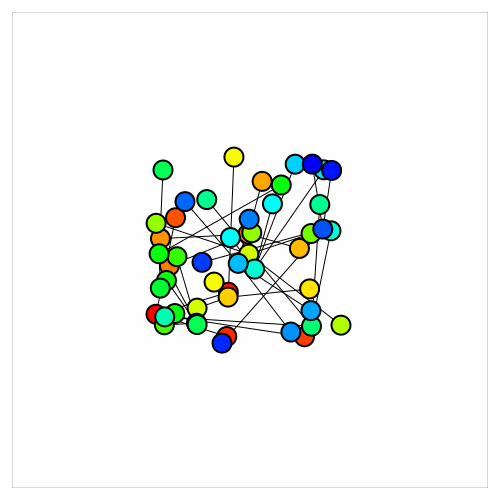

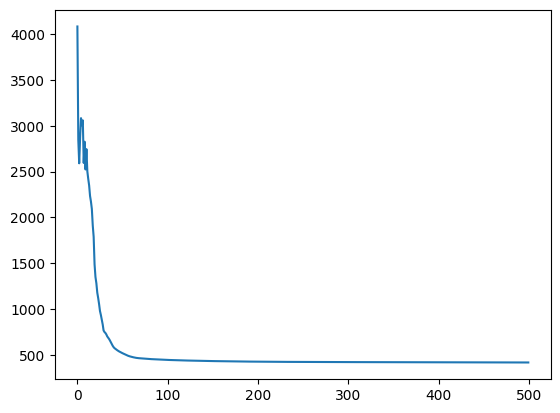

In [25]:
def L2(x):
    return (x * x).sum(-1)


@jax.jit
def force_directed(x, edges, a=1 / 20, b=1 / 10, c=50, spring=0.04):
    # Draw nodes
    size = x.shape[0]
    nodes = np.arange(size)
    color = np.stack([to_color(c) for c in Color("red").range_to("blue", size)])

    @jax.vmap
    def dots(p, i, color):
        d = circle(0.1).translate(p[0], p[1]).fill_color(color)
        return d, np.abs(x).sum()

    out, gravity = dots(x, np.arange(size), color)

    # draw edges
    @jax.vmap
    def connect(inp, out):
        a, b = x[inp], x[out]
        return make_path([(a[0], a[1]), (b[0] + eps, b[1] + eps)]), L2(a - b)

    lines, tension = connect(nodes, edges)

    # Style
    out = out.with_envelope(empty()).line_width(2)
    out = (
        rectangle(5, 5).fill_color("white")
        + lines.with_envelope(empty()).line_width(1)
        + out
    )

    # Repulse everyone but ourself
    repulse = ((1 / (1e-3 + L2(x[:, None] - x))) * (1 - np.eye(size))).sum()

    score = a * gravity.sum() + b * repulse + c * L2(tension - spring)

    return score, out.layout(500)


# Make little clusters
size = 50
around = 5
groups = size // around
matrix = jax.random.uniform(jax.random.PRNGKey(0), (size, 2)) * 2 - 1
edges = (np.arange(size) // around) * around
opt(matrix, partial(force_directed, edges=edges), steps=500)


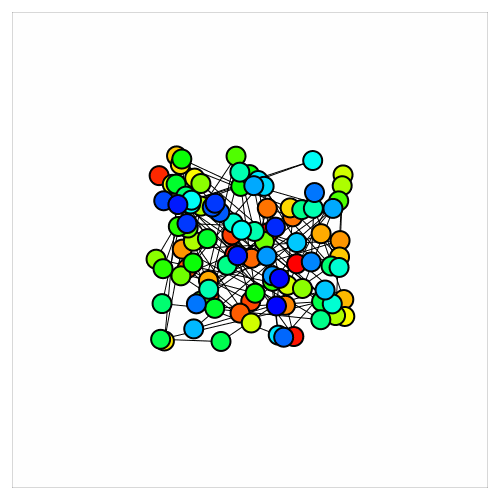

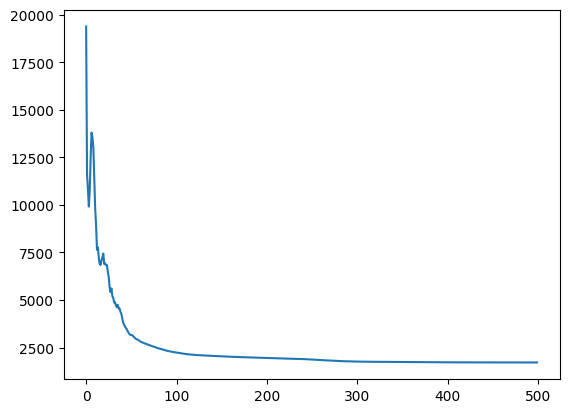

In [26]:
size = 100
matrix = jax.random.uniform(jax.random.PRNGKey(0), (size, 2)) * 2 - 1
edges = (np.arange(size) + 1) % 10 + (np.arange(size) // 10) * 10
opt(matrix, partial(force_directed, edges=edges), steps=500)

# Rendering

In [27]:
def scanline_demo(t, shape):
    return render_trace(shape, P2(1, 1 + 10 * t), V2(1, 0))[0]


shape = crescent()[2].scale(7).rotate(70).translate(6, 8).fill_color("orange")
animate(partial(scan, shape=shape), grid=hgrid, steps=100)

NameError: name 'scan' is not defined

In [ ]:
SIZE = 100
blank = np.ones((SIZE, SIZE, 3))


@jax.jit
@jax.vmap
def render_line(splits, mask):
    mask = mask & (splits > 2.0)
    split_int = np.floor(splits).astype(int)
    splits, ind = splits, np.where(mask, split_int, 1000)
    scene = np.zeros(SIZE)
    loc = np.arange(splits.shape[-1]) % 2
    inout = np.where(loc, -1, 1)
    scene = scene.at[ind].add(inout).at[0].set(0)
    scene = np.cumsum(scene, axis=-1)

    return np.where(
        mask.sum() % 2 == 0,
        scene.at[ind]
        .set(np.where(loc, 0, 1) - inout * (splits - split_int))
        .at[0]
        .set(0),
        np.zeros(SIZE),
    )


shape = crescent()[2].scale(70).rotate(70).translate(60, 80).fill_color("orange")

plt.imshow(render_line(*shape.get_trace()(P2(0, np.arange(100)), V2(1, 0))))

In [ ]:
kern = 11
samples = np.arange(kern) - (kern // 2)


def kernel(offset):
    off_samples = samples - offset
    kernel = kern - np.abs(off_samples)
    return np.maximum(0, kernel / (kern - np.abs(samples)).sum())


plt.plot(samples, kernel(0), "o-")
plt.plot(samples - 0.2, kernel(0.2), "o-")

In [ ]:
@jax.vmap
def convolve(line):
    k = kernel(0)
    return jax.vmap(lambda s: line[s + samples] @ k)(np.arange(line.shape[0]))


plt.imshow(convolve(render_line(*shape.get_trace()(P2(0, np.arange(100)), V2(1, 0)))))

In [ ]:
directions = list(map(np.stack, [(V2(0, 1), V2(1, 0)), (V2(1, 0), V2(0, 1))]))


@jax.jit
def render_shape(img, s):
    k = kernel(0)
    S = np.arange(SIZE)
    trace = s.get_trace()

    def render(img, d):
        pt, v = d
        # Scan
        raster = render_line(*trace(tx.to_point(pt * S[:, None, None]), v))
        # Apply a 1d conv
        raster = convolve(raster)
        # Compose
        img = (1 - raster[..., None]) * img + raster[..., None] * s.style.fill_color_
        return np.swapaxes(img, 0, 1), raster

    return jax.lax.scan(render, img, directions)


plt.imshow(render_shape(blank, shape)[0])

In [ ]:
@jax.vmap
def make_shape(i):
    r, g = to_color("red"), to_color("green")
    return shape.translate(-30 + i * 40, -10 + i * 30).fill_color(r * i + g * (1 - i))


def render_shapes(shapes):
    return jax.lax.scan(render_shape, blank, shapes)[0]


plt.imshow(render_shapes(make_shape(np.arange(5) / 5)))

In [ ]:
@jax.jit
def im(t):
    s = shape.center_xy().rotate_by(t).translate(50, 50)
    return render_shape(blank, s)[0]


os.system("rm /tmp/test*.png 2> /dev/null")
for t in range(T):
    plt.imshow(im(t / T))
    plt.savefig(f"/tmp/test.{t:02d}.png")
    plt.clf()

animate_out(sorted(glob.glob("/tmp/test.*.png")))

## Differentiable Rendering

In [ ]:
goal = render_shape(blank, shape)[0]


def make_shape(color):
    return shape.fill_color(color)


def loss(x):
    y = render_shape(blank, x)[0]
    return np.pow(y - goal, 2).sum(), ((hgrid + x) | (hgrid + shape)).layout(500)


opt(chalk.style.to_color("blue"), lambda x: loss(make_shape(x)), rate=0.1)

In [ ]:
@jax.vmap
def make_shape1(p):
    # s = rectangle(31, 31).rotate(1).translate(params[0], params[1]).fill_color("green")
    loc, color = p
    return (
        shape.center_xy()
        .rotate_by(1 / 4)
        .scale(5)
        .translate(loc[0], loc[1])
        .fill_color(color)
    )


start_param = (
    np.array([[30, 40], [60.0, 60.0]], np.float64),
    np.stack([chalk.style.to_color("orange"), chalk.style.to_color("blue")]),
)
start = make_shape1(start_param)
plt.imshow(render_shapes(start))
# plt.imshow(render_shapes(star(g))[2, 0])

In [ ]:
# t = list(star(g))[2].get_trace()
# for i in range(100):
#     s, m = t(P2(0, i), V2(1, 0))
#     print(i, m.sum())
# plt.imshow(render_shape(blank, list(star(g))[2])[0])

In [ ]:
@jax.custom_vjp
def boundary(scene, splits, mask):
    return scene


def f_fwd(scene, splits, mask):
    return scene, (scene, splits, mask)


def f_bwd(res, g):
    scene, splits, mask = res
    split_int = np.floor(splits).astype(int)

    def grad_p(s, s_off):
        off = s_off - s
        v = g[s + samples]
        return (v * (scene[s + 1] - scene[s - 1])).sum(-1) @ kernel(off)

    r = jax.vmap(grad_p, in_axes=(-1, -1))(split_int, splits) * (mask & (splits > 2))
    return g, -r, None


boundary.defvjp(f_fwd, f_bwd)

In [ ]:
@jax.jit
def boundary_shape(img, s):
    S = np.arange(SIZE)
    # img2 = np.zeros(img.shape)
    trace = s.get_trace()

    def bound(img, d):
        pt, v, axis = d
        s, m = jax.vmap(lambda i: trace(tx.to_point(pt * i), v))(S)
        bound = lambda s, m: jax.vmap(lambda s, m, im: boundary(im, s, m))(s, m, img)
        img = bound(s, m)
        return np.swapaxes(img, 0, 1), None

    return jax.lax.scan(bound, img, directions)[0], None

    # for pt, v, axis in directions:
    #     for s in ls:
    #         trace = s.get_trace()
    #         s, m = jax.vmap(lambda i: trace(tx.to_point(pt * i), v))(S)
    #         bound = lambda s, m: jax.vmap(lambda s, m, im: boundary(im, s, m))(s, m, img)
    #         img = bound(s, m)


def boundaries(img, shapes):
    return jax.lax.scan(boundary_shape, img, shapes)[0]

    # if draw:
    #     split_int = np.floor(s).astype(int)
    #     grad = jax.grad(lambda s, m: bound(s, m).sum())(s, m)
    #     for i in S:
    #         for p in range(grad.shape[2]):
    #             if np.abs(grad[i, :, p]) > 0 and m[i, :, p]:
    #                 img2 = img2.at[i, split_int[i, :, p ]].set(
    #                     np.where(grad[i, :, p] > 0,
    #                             chalk.style.to_color("red") if axis == 0 else chalk.style.to_color("green"),
    #                              chalk.style.to_color("blue")if axis == 0 else chalk.style.to_color("yellow") ))
    # img, img2 = np.swapaxes(img, 0, 1), np.swapaxes(img2, 0, 1)


#     return img, np.where(img2.sum(-1)[:, :, None] > 0, img2, img)
# def boundaries():
#     jax.lax.scan

img = render_shapes(start)
img = boundaries(img, start)
# r = jax.grad(lambda i, s: np.sum(boundaries(i,s )))(img, start)[1]
plt.imshow(img)

In [ ]:
plt.imshow(render_shapes(make_shape1(start_param)))

In [ ]:
goal_shapes = make_shape1(
    (
        np.array([[50, 20], [40, 50]]),
        np.stack([chalk.style.to_color("blue"), chalk.style.to_color("orange")]),
    )
)

goal = render_shapes(goal_shapes)
start_param = (
    np.array([[30, 20], [60.0, 60.0]], np.float64),
    np.stack([chalk.style.to_color("green"), chalk.style.to_color("green")]),
)


def loss(goal, goal_shapes, x):
    y = render_shapes(x)
    y = boundaries(y, x)
    return np.pow(y - goal, 2).sum(), chalk.core.layout_primitives(
        (
            bgrid
            + concat(x).with_envelope(empty())
            + concat(goal_shapes).with_envelope(empty()).fill_opacity(0.2)
        ),
        100,
    )


opt(
    start_param,
    lambda x: loss(goal, goal_shapes, make_shape1(x)),
    steps=1000,
    save_every=5,
    verbose=False,
    rate=0.1,
)

In [ ]:
@jax.vmap
def make_shape2(params):
    s, l, r = params
    s = np.where(np.abs(s) < 1e-3, 1e-3, s)
    part1 = arc_seg(unit_x, s[0])
    part2 = arc_seg(unit_y, s[1])
    part3 = arc_seg(-unit_x, s[2])
    part4 = arc_seg(-unit_y, s[3])
    d = (part1 + part2 + part3 + part4).close().stroke()
    shape = d.scale(12 + r[0]).rotate(70)
    return shape.center_xy().rotate_by(0).translate(50, 30).fill_color("blue")


goal_params = (
    np.array([[0.5, 0.2, 0.7, -0.9]]),
    np.array([[50.0, 30]]),
    np.array([[5.0]]),
)
goal_shapes = make_shape2(goal_params)
goal = render_shapes(goal_shapes)
start_param = (np.array([[-0.5, 0.1, 2, 1]]), np.array([[50.0, 30]]), np.array([[0.0]]))
# hgrid + make_shape2(start_param)
opt(
    start_param,
    lambda x: loss(goal, goal_shapes, make_shape2(x)),
    steps=1000,
    save_every=5,
    rate=0.01,
    verbose=False,
)

In [ ]:
plt.imshow(render_shapes(make_shape2(start_param)))

## Demos 

In [ ]:
@jax.vmap
def make_shape3(params, i):
    # s = []
    s, l = params
    s = np.minimum(np.maximum(s, 5.0), 15)
    red, blue = chalk.style.to_color("red"), chalk.style.to_color("blue")
    return (
        circle_at(tx.X.origin, s)
        .translate(l[0], l[1])
        .fill_color(np.where(i % 2, red, blue))
    )


make_shape3 = partial(make_shape3, i=np.arange(10.0))

goal_param = (
    np.array([10 + random.random() for i in range(10)]),
    np.array([20 + random.random() * 40 for i in range(20)]).reshape(10, 2),
)
goal_shapes = make_shape3(goal_param)
# hgrid + goal_shapes

make_shape3 = partial(make_shape3, i=np.arange(20.0))

goal = render_shapes(goal_shapes)
start_param = (
    np.array([10 + random.random() for i in range(20)]),
    np.array([20 + 50 * random.random() for i in range(40)], np.float64).reshape(20, 2),
)

# hgrid + _shapes
opt(
    start_param,
    lambda x: loss(goal, goal_shapes, make_shape3(x)),
    steps=1000,
    save_every=5,
    rate=0.1,
    verbose=False,
)

In [ ]:
@jax.vmap
def star(x):
    sides = 5
    edge = Trail.hrule(1)
    return (
        Trail.concat(edge.rotate_by((i) / sides) for i in range(sides))
        .close()
        .stroke()
        .center_xy()
        .scale(15)
        .rotate_by(x[1])
        .translate(25 + x[2], 25 + x[3])
        .fill_color("orange")
    )


start_param = np.array(
    [
        [15.0, random.random(), 5 + i * 20, 10 + 20 * j]
        for i in range(3)
        for j in range(3)
    ]
)
g = np.array(
    [
        [15.0, random.random(), 1 + i * 20, 1 + 20 * j]
        for i in range(3)
        for j in range(3)
    ]
)
goal_shapes = star(g)
goal = render_shapes(star(g))

opt(
    start_param,
    lambda x: loss(goal, goal_shapes, star(x)),
    steps=500,
    save_every=10,
    rate=0.05,
    verbose=False,
)

In [ ]:
@jax.vmap
def star(x):
    sides = 5
    edge = Trail.hrule(1)
    return (
        Trail.concat(edge.rotate_by((2 * i) / sides) for i in range(sides))
        .close()
        .stroke()
        .scale(x[0])
        .rotate(x[1])
        .align_tl()
        .translate(10 + x[2], x[3])
        .fill_color(x[4:7])
    )


start_param = np.array([[45.0, 20, 1, 10, 1.0, 0.0, 0.0]])
g = np.array([[35.0, 9, 10, 30, 0.0, 1.0, 0.0]])
goal_shapes = star(g)
goal = render_shapes(star(g))

opt(
    start_param,
    lambda x: loss(goal, goal_shapes, star(x)),
    steps=500,
    save_every=10,
    rate=0.1,
    verbose=False,
)

In [ ]:
# plt.imshow(goal)
plt.imshow(render_shapes(star(start_param)))

In [ ]:
plt.imshow(goal)

In [ ]:
aff = tx.translation(V2(2, 3))
(aff @ z).show_origin()

In [ ]:
concat([tx.translation(V2(2 * i, 3)) @ z for i in range(3)])

In [ ]:
t = seg(V2(1, 0)) + seg(V2(2, 3))
t.stroke().show_origin()

In [ ]:
t = seg(V2(1, 0)) + seg(V2(1, 1)) + seg(V2(-1, 0)) + seg(V2(-1, -1))
t.close().stroke()

In [ ]:
t = arc_seg(V2(1, 0), 0.5).stroke()
t

In [ ]:
turn = tx.rotation(np.pi)
x = arc_seg(V2(1, 0), 0.5)

circle = (x + (turn @ x)).close().stroke()

circle = tx.translation(V2(-0.5, 0)) @ circle
circle.show_origin()

In [ ]:
t = [arc_seg(V2(1, 0), i / 5).stroke() for i in range(1, 5)]
concat(t)

In [ ]:
p = P2(4, 5)
p

In [ ]:
def line(p1, p2):
    return tx.translation(p1) @ seg(p2 - p1).stroke()


line(P2(2, 2), P2(4, 5)).show_origin()

In [ ]:
def draw_point(p):
    return tx.translation(p) @ circle.fill_color("red")


draw_point(p).show_origin()

In [ ]:
big_circle = tx.scale(V2(5, 5)) @ circle
trace = big_circle.get_trace()
v = V2(-4, -5)
p2, m2 = trace(p, v)
(
    big_circle
    + draw_point(p)
    + concat(
        [draw_point(i * v + p).fill_color("blue") for i, j in zip(p2[0], m2[0]) if j]
    )
)

In [ ]:
type(circle)

In [ ]:
p_many = P2(np.arange(5), np.array([5] * 5))
draw_point(p_many).show_origin()

In [ ]:
p_many = P2(np.arange(5), np.array(5))
v_many = tx.to_vec(p_many)
p2, m2 = trace(p_many, -v_many)
colors = list(Color("blue").range_to("red", 5))
big_circle + concat(
    [
        (draw_point(p_many[k]) + draw_point(i * -v_many[k] + p_many[k])).fill_color(
            colors[k]
        )
        for k in range(p2.shape[0])
        for i, j in zip(p2[k], m2[k])
        if j
    ]
)